# Plot heatmap and clustermap with Immune Gene Classifier in Sia's paper

# Questions:
### Which genes to be used?
1. All the genes in Mondor list (767 genes)
2. Only those overlapping with Immune classifier in Sia's paper (33 genes)
3. Overlapping genes + other genes

### What normalization is the FireHose data?

### What further data processing should we apply? Is it correct to process data by row (gene)?
1. Normalization: x / sum(x)
2. Normalization: (x-xmin) / (xmax-xmin)
3. Rescaling: x / xmax
4. Zscore: x = (x – μ) / σ
5. Zscore then log2: z = (x – μ) / σ, x = log2(z-zmin+1)
6. Normalization then log2: x = (x-xmin) / (xmax-xmin), x = log2(z-zmin+1)
7. Rescaling then log2: x = x / xmax, x = log2(x-xmin+1)
8. Raw data without processing

### Clustering: what method and what metric to be used?

### What colormap is the most used for gene expression heatmap?

### How many samples should Immune Class contain? 

### How many clusters?

In [1]:
import pandas as pd
# matplotlib 3.1.2 have a problem of cutting off the top and bottom boxes
# !conda install -c conda-forge matplotlib=3.1.2
import matplotlib
import matplotlib.pyplot as plt
# After seaborn 0.9.0, control the LineCollection properties of the dendrogram by using the tree_kws parameter
# !conda install -c conda-forge seaborn=0.10.0
import seaborn as sns
import numpy as np
from sklearn import preprocessing
from scipy import stats
from scipy.spatial import distance
from scipy.cluster import hierarchy
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster, cophenet, ward
from matplotlib.patches import Rectangle

## Load and visualize data

In [2]:
firehose = pd.read_csv('E:\\deeplearning\\Hepatocarcinomes\\TCGA\\processed\\firebrowse_filtered_nohousekeeping_HCC.csv', sep='\t')
classifier = pd.read_excel('E:\\deeplearning\\Hepatocarcinomes\\TCGA\\classifier_genes_Sia_UPPER.xlsx')

In [3]:
display(firehose.head(5))
print(firehose.shape) # (747, 430)
display(classifier.head(5))
print(classifier.shape) # (112,3)

,"(Gene name, RefSeq mRNA ID)",Gene ID,Gene Name,Hybridization REF,Official.Gene.Name,Probe.Label,ProbeID,TCGA-2V-A95S-01A-11R-A37K-07 normalized_count,TCGA-2Y-A9GS-01A-12R-A38B-07 normalized_count,TCGA-2Y-A9GT-01A-11R-A38B-07 normalized_count,...,TCGA-ZP-A9CZ-01A-11R-A38B-07 normalized_count,TCGA-ZP-A9D0-01A-11R-A37K-07 normalized_count,TCGA-ZP-A9D1-01A-11R-A38B-07 normalized_count,TCGA-ZP-A9D4-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CD-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CE-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CF-01A-11R-A38B-07 normalized_count,TCGA-ZS-A9CG-01A-11R-A37K-07 normalized_count,TCGA-DD-AACA-02B-11R-A41C-07 normalized_count,TCGA-ZS-A9CF-02A-11R-A38B-07 normalized_count
0,CDKN2A|NM_000077,1029,CDKN2A,CDKN2A|1029,CDKN2A,CDKN2A,NM_000077,531.6827,290.7836,373.9072,...,831.2898,12.2265,180.0643,417.4798,177.3103,203.5011,1241.9021,115.8526,6.9076,483.3127
1,GBP2|NM_004120,2634,GBP2,GBP2|2634,GBP2,GBP2,NM_004120,9774.1391,2388.5264,1472.8447,...,3089.5546,3340.7915,2271.6977,297.2027,2364.2675,1662.3851,2497.7464,1179.5099,875.2930,2851.3782
2,TLR8|NM_138636,51311,TLR8,TLR8|51311,TLR8,TLR8,NM_138636,115.9798,49.7782,51.1096,...,55.8746,18.6615,18.0064,11.8795,17.2802,0.5470,23.4321,6.1697,0.9868,13.5970
3,SNCA|NM_001146055,6622,SNCA,SNCA|6622,SNCA,SNCA,NM_001146055,7.1673,5.4214,0.8967,...,8.6916,5.1480,3.8585,0.5657,7.5131,0.5470,10.3377,6.8552,0.0000,2.4722
4,BIRC3|NM_001165,330,BIRC3,BIRC3|330,BIRC3,BIRC3,NM_001165,20079.4918,1065.5495,1761.9368,...,1060.3756,199.4852,7423.1511,391.4581,2708.4899,240.1532,957.9600,132.3051,165.7827,580.9642


(747, 360)


,ID name,Gene name,class
0,PAGE4,PAGE4,Rest
1,UGT2B17,UGT2B17,Rest
2,C1QTNF3,C1QTNF3,Rest
3,DHRS2,DHRS2,Rest
4,FAM133A,FAM133A,Rest


(112, 3)


## Preprocess
#### data_full: Gene Name (index), normalized counts. All the genes in Mondor list.

In [4]:
# Keep only the gene names (as index) and counts
data_full = firehose.drop(["(Gene name, RefSeq mRNA ID)", "Gene ID", "Hybridization REF", "Official.Gene.Name", "Probe.Label", "ProbeID"], 1)
data_full.set_index("Gene Name", inplace=True)
data_full.columns = [ncol[:-17] for ncol in data_full.columns]
print(data_full.shape)
display(data_full.head(3))

(747, 353)


,TCGA-2V-A95S-01A-11R-A37K-07,TCGA-2Y-A9GS-01A-12R-A38B-07,TCGA-2Y-A9GT-01A-11R-A38B-07,TCGA-2Y-A9GU-01A-11R-A38B-07,TCGA-2Y-A9GV-01A-11R-A38B-07,TCGA-2Y-A9GW-01A-11R-A38B-07,TCGA-2Y-A9GX-01A-11R-A38B-07,TCGA-2Y-A9GY-01A-11R-A38B-07,TCGA-2Y-A9GZ-01A-11R-A39D-07,TCGA-2Y-A9H0-01A-11R-A38B-07,...,TCGA-ZP-A9CZ-01A-11R-A38B-07,TCGA-ZP-A9D0-01A-11R-A37K-07,TCGA-ZP-A9D1-01A-11R-A38B-07,TCGA-ZP-A9D4-01A-11R-A37K-07,TCGA-ZS-A9CD-01A-11R-A37K-07,TCGA-ZS-A9CE-01A-11R-A37K-07,TCGA-ZS-A9CF-01A-11R-A38B-07,TCGA-ZS-A9CG-01A-11R-A37K-07,TCGA-DD-AACA-02B-11R-A41C-07,TCGA-ZS-A9CF-02A-11R-A38B-07
Gene Name,,,,,,,,,,,,,,,,,,,,,
CDKN2A,531.6827,290.7836,373.9072,28.3607,83.7563,219.9234,146.6667,1216.3899,482.5939,690.0219,...,831.2898,12.2265,180.0643,417.4798,177.3103,203.5011,1241.9021,115.8526,6.9076,483.3127
GBP2,9774.1391,2388.5264,1472.8447,1203.7553,1381.2521,1681.1111,2081.8061,2578.0825,2866.3481,5070.2221,...,3089.5546,3340.7915,2271.6977,297.2027,2364.2675,1662.3851,2497.7464,1179.5099,875.2930,2851.3782
TLR8,115.9798,49.7782,51.1096,17.5169,50.7614,250.5747,115.7576,141.9389,9.5563,21.2699,...,55.8746,18.6615,18.0064,11.8795,17.2802,0.5470,23.4321,6.1697,0.9868,13.5970


#### data_classifier: Gene Name (index), normalized counts. Only genes overlap with Immune classifier in Sia's paper.

In [5]:
# Classifier genes existing in Mondor list
set1 = set(classifier["ID name"])
set2 = set(firehose["Gene Name"]).union(set(firehose["Official.Gene.Name"]).union(set(firehose["Probe.Label"])))
set_classifier = set1.intersection(set2)
print(len(set_classifier))
print(set_classifier)

33
{'CD3D', 'PTPRC', 'GZMB', 'CCL4', 'CCL2', 'CD2', 'CXCR4', 'GZMK', 'CCL5', 'CXCL6', 'MMP9', 'CD48', 'LTB', 'GZMH', 'CD38', 'HLA-DRB5', 'CD8A', 'MMP7', 'CD27', 'CCL21', 'GZMA', 'MS4A1', 'ID4', 'CCL18', 'SAMSN1', 'C7', 'DUSP2', 'CXCL14', 'CCL19', 'IL7R', 'COL6A3', 'ITGB2', 'CXCL9'}


In [6]:
# Filter the data related to classifier genes by names
data_classifier = pd.DataFrame(columns=firehose.columns)
for name in set_classifier:
    for column in ["Gene Name", "Official.Gene.Name", "Probe.Label"]:
            data_classifier = pd.concat([data_classifier, firehose[firehose[column]==name]])
data_classifier.drop_duplicates(inplace=True)

print(data_classifier.shape)
display(data_classifier.head(5))

(33, 360)


,"(Gene name, RefSeq mRNA ID)",Gene ID,Gene Name,Hybridization REF,Official.Gene.Name,Probe.Label,ProbeID,TCGA-2V-A95S-01A-11R-A37K-07 normalized_count,TCGA-2Y-A9GS-01A-12R-A38B-07 normalized_count,TCGA-2Y-A9GT-01A-11R-A38B-07 normalized_count,...,TCGA-ZP-A9CZ-01A-11R-A38B-07 normalized_count,TCGA-ZP-A9D0-01A-11R-A37K-07 normalized_count,TCGA-ZP-A9D1-01A-11R-A38B-07 normalized_count,TCGA-ZP-A9D4-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CD-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CE-01A-11R-A37K-07 normalized_count,TCGA-ZS-A9CF-01A-11R-A38B-07 normalized_count,TCGA-ZS-A9CG-01A-11R-A37K-07 normalized_count,TCGA-DD-AACA-02B-11R-A41C-07 normalized_count,TCGA-ZS-A9CF-02A-11R-A38B-07 normalized_count
312,CD3D|NM_000732,915,CD3D,CD3D|915,CD3D,CD3D,NM_000732,605.3103,50.2711,264.5147,...,117.3366,9.0090,102.8939,10.7481,36.0631,4.9234,43.4183,25.3642,4.4406,50.6799
664,PTPRC|NM_080921,5788,PTPRC,PTPRC|5788,PTPRC,PTPRC,NM_080921,1484.2808,367.6688,1318.0901,...,711.4698,174.3887,591.6399,148.2110,226.8971,237.4179,444.5210,163.8389,26.6436,378.8628
426,GZMB|NM_004131,3002,GZMB,GZMB|3002,GZMB,GZMB,NM_004131,523.2122,13.7999,29.5898,...,70.1537,9.0090,21.2219,12.4452,21.0368,4.9234,8.2702,30.8483,17.2690,11.7429
64,CCL4|NM_002984,6351,CCL4,CCL4|6351,CCL4,CCL4,NM_002984,440.4626,68.0138,213.4051,...,170.7279,34.7490,81.0289,32.2444,98.4222,12.5821,82.0124,189.2031,20.2294,60.5686
39,CCL2|NM_002982,6347,CCL2,CCL2|6347,CCL2,CCL2,NM_002982,305.5872,196.1557,206.2318,...,410.3678,147.3616,149.8392,129.5432,174.3050,94.6389,190.2136,84.3188,27.1370,563.6588


In [7]:
# Keep only the gene names (as index) and counts
data_classifier.drop(["(Gene name, RefSeq mRNA ID)", "Gene ID", "Hybridization REF", "Official.Gene.Name", "Probe.Label", "ProbeID"], 1, inplace=True)
data_classifier.set_index("Gene Name", inplace=True)
data_classifier.columns = [ncol[:-17] for ncol in data_classifier.columns]
print(data_classifier.shape)
display(data_classifier.head(3))

(33, 353)


,TCGA-2V-A95S-01A-11R-A37K-07,TCGA-2Y-A9GS-01A-12R-A38B-07,TCGA-2Y-A9GT-01A-11R-A38B-07,TCGA-2Y-A9GU-01A-11R-A38B-07,TCGA-2Y-A9GV-01A-11R-A38B-07,TCGA-2Y-A9GW-01A-11R-A38B-07,TCGA-2Y-A9GX-01A-11R-A38B-07,TCGA-2Y-A9GY-01A-11R-A38B-07,TCGA-2Y-A9GZ-01A-11R-A39D-07,TCGA-2Y-A9H0-01A-11R-A38B-07,...,TCGA-ZP-A9CZ-01A-11R-A38B-07,TCGA-ZP-A9D0-01A-11R-A37K-07,TCGA-ZP-A9D1-01A-11R-A38B-07,TCGA-ZP-A9D4-01A-11R-A37K-07,TCGA-ZS-A9CD-01A-11R-A37K-07,TCGA-ZS-A9CE-01A-11R-A37K-07,TCGA-ZS-A9CF-01A-11R-A38B-07,TCGA-ZS-A9CG-01A-11R-A37K-07,TCGA-DD-AACA-02B-11R-A41C-07,TCGA-ZS-A9CF-02A-11R-A38B-07
Gene Name,,,,,,,,,,,,,,,,,,,,,
CD3D,605.3103,50.2711,264.5147,21.6876,39.7631,169.3487,190.9091,485.2705,15.6997,243.3531,...,117.3366,9.0090,102.8939,10.7481,36.0631,4.9234,43.4183,25.3642,4.4406,50.6799
PTPRC,1484.2808,367.6688,1318.0901,251.9102,515.2284,1045.9770,1840.0000,919.1216,107.1672,458.5549,...,711.4698,174.3887,591.6399,148.2110,226.8971,237.4179,444.5210,163.8389,26.6436,378.8628
GZMB,523.2122,13.7999,29.5898,5.8390,5.0761,12.2605,21.2121,325.1205,8.1911,214.5762,...,70.1537,9.0090,21.2219,12.4452,21.0368,4.9234,8.2702,30.8483,17.2690,11.7429


In [8]:
print("Number of 0 or missing data: " + str((data_classifier==0.0000).sum().sum()))

Number of 0 or missing data: 253


In [9]:
def draw_histograms_sample(df, n_rows=3, n_cols=3):
    sns.set(font_scale=1.5)
    fig=plt.figure(figsize = (20,20))
    
    np.random.seed(0)
    data = df[df.columns[np.random.randint(351, size=9)]]

    i=1
    for nvar, var_name in enumerate(data.columns):
        ax=fig.add_subplot(n_rows,n_cols,i)
        data[var_name].hist(bins=50,ax=ax)
        ax.set_title(var_name+" Distribution")
        i=i+1
#     fig.tight_layout()  # Improves appearance a bit.
#     plt.show()
    
    return fig

In [27]:
def plot_data(dname="classifier", precomp=False, transform=None, histogram=True, boxplot=True, heatmap=True, clustermap=True, 
              clusters_row=None, clusters_col=None, row_cluster=True, col_cluster=True, dend=True, xticklabels=True, 
              method="complete", metric="euclidean", cmap="PiYG", figsize=(288, 72), dpi=100):
    
    # Process data
    if transform == "nor1": # normalization by row (gene): x / sum(x)
        data = data_classifier.div(data_classifier.sum(axis=1), axis=0)
        if dname == "full":
            data_pcomp = data
            # there are all 0 rows
            data = data_full.div(data_full.sum(axis=1)+1.e-17, axis=0)
    
    if transform == "nor1": # normalization by row (gene): x / sum(x)
        data = data_classifier.div(data_classifier.sum(axis=1), axis=0)
        if dname == "full":
            data_pcomp = data
            # there are all 0 rows
            data = data_full.div(data_full.sum(axis=1)+1.e-17, axis=0)
            
    elif transform == "nor2": # normalization by row (gene): (x-xmin) / (xmax-xmin)
        data = data_classifier.sub(data_classifier.min(axis=1), axis=0).div(data_classifier.max(axis=1).
                                                                            sub(data_classifier.min(axis=1), axis=0), axis=0)
        if dname == "full":
            data_pcomp = data
            data = data_full.sub(data_full.min(axis=1), axis=0).div(data_full.max(axis=1).sub(data_full.min(axis=1), axis=0)
                                                                    +1.e-17, axis=0)
#         # this built function will give the same results. But need to give the right data
#         min_max_scaler = preprocessing.MinMaxScaler() 
#         x_scaled = min_max_scaler.fit_transform(data.T.values)
#         data = pd.DataFrame(x_scaled.T, columns=data.columns, index=data.index)

    elif transform == "rescale": # rescale by row (gene): x / xmax
        data = data_classifier.div(data_classifier.max(axis=1), axis=0)
        if dname == "full":
            data_pcomp = data
            data = data_full.div(data_full.max(axis=1)+1.e-17, axis=0)  
          
    elif transform == "zscore": # Apply Zscore then log2 by row (gene): z = (x – μ) / σ
        # only transform for the samples
        # axis=1 means across the row, scale each col
        data = pd.DataFrame(stats.zscore(data_classifier, axis=1), columns=data_classifier.columns, index=data_classifier.index)
        # shift to a smallest value of 1
        if dname == "full":
            data_pcomp = data
            data = pd.DataFrame(stats.zscore(data_full+1.e-17, axis=1), columns=data_full.columns, index=data_full.index)
            
    elif transform == "zscore-log2": # Apply Zscore then log2 by row (gene): z = (x – μ) / σ, x = log2(z-zmin+1)
        # only transform for the samples
        # axis=1 means across the row, scale each col
        zscore = pd.DataFrame(stats.zscore(data_classifier, axis=1), columns=data_classifier.columns, index=data_classifier.index)
        # shift to a smallest value of 1
        zscore = 1 + zscore.sub(zscore.min(axis=1),axis=0)
        data = np.log2(zscore)
        if dname == "full":
            data_pcomp = data
            zscore = pd.DataFrame(stats.zscore(data_full+1.e-17, axis=1), columns=data_full.columns, index=data_full.index)
            zscore = 1 + zscore.sub(zscore.min(axis=1),axis=0)
            data = np.log2(zscore)

    elif transform == "log2-02min": # Apply Zscore then log2 by row (gene): x = log2(x) with x=0 replaced with xmin
        data = data_classifier
        min_nonzero = data[data != 0.].min(axis=0).min()
        data[data == 0] = min_nonzero
        data = np.log2(data)
        if dname == "full":
            data_pcomp = data
            data = data_full
            min_nonzero = data[data != 0.].min(axis=0).min()
            data[data == 0] = min_nonzero
            data = np.log2(data)
            
    elif transform == "log2": # Apply Zscore then log2 by row (gene): x = log2(x-xmin+1)
        # shift to a smallest value of 1
        data = 1 + data_classifier.sub(data_classifier.min(axis=1),axis=0)
        data = np.log2(data)
        if dname == "full":
            data_pcomp = data
             # shift to a smallest value of 1
            data = 1 + data_full.sub(data_full.min(axis=1),axis=0)
            data = np.log2(data)
            
    elif transform == "log2-zscore": # Apply Zscore then log2 by row (gene): x = log2(x-xmin+1), x = (x – μ) / σ, 
        # shift to a smallest value of 1
        data = 1 + data_classifier.sub(data_classifier.min(axis=1),axis=0)
        data = np.log2(data)
        data = pd.DataFrame(stats.zscore(data, axis=1), columns=data_classifier.columns, index=data_classifier.index)
        if dname == "full":
            data_pcomp = data
            data = 1 + data_full.sub(data_full.min(axis=1),axis=0)
            data = np.log2(data)
            data = pd.DataFrame(stats.zscore(data+1.e-17, axis=1), columns=data_full.columns, index=data_full.index)
            
    elif transform == "log2-02min-zscore": # Apply log2 then Zscore by row (gene): x = log2(x) with x=0 replaced with xmin, 
                                            # x = (x – μ) / σ
        data = data_classifier
        min_nonzero = data[data != 0.].min(axis=0).min()
        data[data == 0] = min_nonzero
        data = np.log2(data)
        data = pd.DataFrame(stats.zscore(data, axis=1), columns=data_classifier.columns, index=data_classifier.index)
        if dname == "full":
            data_pcomp = data
            data = data_full
            min_nonzero = data[data != 0.].min(axis=0).min()
            data[data == 0] = min_nonzero
            data = np.log2(data)
            data = pd.DataFrame(stats.zscore(data+1.e-17, axis=1), columns=data_full.columns, index=data_full.index)
        
    elif transform == "nor2-log2": # Normalization then log2 by row (gene): x = (x-xmin) / (xmax-xmin), x = log2(z-zmin+1)
        data = data_classifier.sub(data_classifier.min(axis=1), axis=0).div(data_classifier.max(axis=1).
                                                                            sub(data_classifier.min(axis=1), axis=0), axis=0)
        data = 1 + data.sub(data.min(axis=1),axis=0)
        data = np.log2(data)
        if dname == "full":
            data_pcomp = data
            data = data_full.sub(data_full.min(axis=1), axis=0).div(data_full.max(axis=1).sub(data_full.min(axis=1), axis=0)
                                                                    +1.e-17, axis=0)   
            data = 1 + data.sub(data.min(axis=1),axis=0)
            data = np.log2(data)
        
    elif transform == "rescale-log2": # rescale then log2 by row (gene): x = x / xmax, x = log2(x-xmin+1)
        data = data_classifier.div(data_classifier.max(axis=1), axis=0)
        data = 1 + data.sub(data.min(axis=1), axis=0)
        data = np.log2(data)
        if dname == "full":
            data_pcomp = data
            data = data_full.div(data_full.max(axis=1)+1.e-17, axis=0)   
            data = 1 + data.sub(data.min(axis=1), axis=0)
            data = np.log2(data)
        
    else:
        data = data_classifier
        transform = ""
        if dname == "full":
            data_pcomp = data
            data = data_full
        
        
    if dname == "full":
        sns.set(font_scale=2)
        if figsize == (288, 72):
            figsize = (288, 300)
    elif dname == "classifier":
        sns.set(font_scale=3.5) # adjust font size in all the plots
        
    # Pick up random sample col to show the distribution as histogram
    if histogram:
        fig = draw_histograms_sample(data)
        fig.show()
        plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\sample_distribution_{0}_{1}.png".format(dname, transform))
        
    # Boxplot to find out the outliers
    if boxplot:
#         plt.rcParams.keys()
        plt.rcParams["boxplot.boxprops.linewidth"] = 3
        bp = data.T.plot.box(figsize=(288, 72), showmeans=True)
        plt.xticks(rotation=60)
        plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\boxplot_{0}_{1}.png".format(dname, transform), dpi=dpi)
#         plt.show()
        del(bp)
        
    # Heatmap
    if heatmap:
        plt.figure(figsize=figsize)
        hm = sns.heatmap(data, xticklabels=xticklabels, cmap=cmap, annot=True, fmt='.3f', annot_kws={"size": 5, "color":"k"})
        plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\heatmap_{0}_{1}.png".format(dname, transform), 
                    dpi=dpi)
#         plt.show()
        del(hm)
        
    # Clustered heatmap
    cm = False
    if clustermap:
        if clusters_row is not None:
            colors_row = matplotlib.cm.rainbow(np.linspace(0, 1, len(clusters_row.unique())))
            lut_row = dict(zip(clusters_row.unique(), colors_row))
            row_colors = clusters_row.map(lut_row)
            row_colors.name = "Gene cluster"
            
        else:
            row_colors = None
                
        if clusters_col is not None:
            colors_col = matplotlib.cm.rainbow(np.linspace(0, 1, len(clusters_col.unique())))
            lut_col = dict(zip(clusters_col.unique(), colors_col))
            col_colors = clusters_col.map(lut_col)
            col_colors.name = "Sample cluster"
            
        else:
            col_colors = None
        
        if dname == "full":
            if precomp:
                col_linkage = hierarchy.linkage(distance.pdist(data_pcomp.T, metric=metric), method=method)
                cm = sns.clustermap(data, col_linkage=col_linkage, method=method, metric=metric, z_score=None,
                                    xticklabels=xticklabels, cmap=cmap, figsize=(figsize[0],figsize[1]*1.5), tree_kws=dict(linewidths=15),
                                    row_colors=row_colors, col_colors=col_colors)
            else:
                cm = sns.clustermap(data, method=method, metric=metric, z_score=None, xticklabels=xticklabels, cmap=cmap, 
                                    figsize=figsize, tree_kws=dict(linewidths=15), row_colors=row_colors, 
                                    col_colors=col_colors, row_cluster=row_cluster, col_cluster=col_cluster)
                
        else:
            cm = sns.clustermap(data, method=method, metric=metric, z_score=None, xticklabels=xticklabels, cmap=cmap, 
                            figsize=(figsize[0],figsize[1]*2.5), tree_kws=dict(linewidths=15), row_colors=row_colors, 
                                col_colors=col_colors, row_cluster=row_cluster, col_cluster=col_cluster)
            
            cm.ax_heatmap.set_yticklabels(cm.ax_heatmap.get_ymajorticklabels(), fontsize=180, rotation=0)
    
        # Use the dendrogram box to reposition the colour bar      
        dendro_box = cm.ax_row_dendrogram.get_position()
        dendro_box_row = cm.ax_row_dendrogram.get_position()
        dendro_box_col = cm.ax_col_dendrogram.get_position()
#         if dname == "full":
#             ratio_1 = 3
#             ratio_2 = 8
#         else:
#             ratio_1 = 6
#             ratio_2 = 8
        dendro_box.x0 = dendro_box_col.x1 + (dendro_box_row.x1 - dendro_box_row.x0)/6
        dendro_box.x1 = dendro_box.x0 + (dendro_box_row.x1 - dendro_box_row.x0)/8
        cm.cax.set_position(dendro_box)
                
        # here set the labelsize by 20
        cm.ax_cbar.tick_params(labelsize=200)
        
        if clusters_row is not None:
            for cluster in sorted(clusters_row.unique()):
                cm.ax_row_dendrogram.bar(0, 0, color=lut_row[cluster], label=cluster, linewidth=0)
                lrow = cm.ax_row_dendrogram.legend(title='Gene Clusters', loc="center", ncol=3, fontsize=180, 
                                                   bbox_to_anchor=((dendro_box_row.x0+dendro_box_row.x1)/2, 
                                                                   (dendro_box_col.y0+dendro_box_col.y1)/2), 
                                                   bbox_transform=plt.gcf().transFigure)
                lrow.get_title().set_fontsize('200')

            for tick_label in cm.ax_heatmap.axes.get_yticklabels():
                tick_text = tick_label.get_text()
                tick_name = clusters_row.loc[tick_text]
                tick_label.set_color(lut_row[tick_name])
               
            ax1 = cm.ax_row_colors
            for item in ([ax1.title, ax1.xaxis.label, ax1.yaxis.label] + ax1.get_xticklabels() + ax1.get_yticklabels()):
                if dname == "full":
                    item.set_fontsize(150)
                else:
                    item.set_fontsize(180)
                item.set_rotation(45)
                item.set_horizontalalignment("right")
                
            rec1 = 0
            for i in range(1, len(set(clusters_row))+1):
                rec1 = rec1 + (clusters_row == i).sum()
#                 if i==3 or i == 4 or i == 5:
#                     edgecolor = "k"
#                 else:
#                     edgecolor = "w"
                edgecolor = "w"
                cm.ax_heatmap.add_patch(Rectangle((0, 0), data.shape[1], rec1, fill=False, edgecolor=edgecolor, lw=10))
                
        if clusters_col is not None:
            for cluster in sorted(clusters_col.unique()):
                cm.ax_col_dendrogram.bar(0, 0, color=lut_col[cluster], label=cluster, linewidth=0)
                lcol = cm.ax_col_dendrogram.legend(title='Sample Clusters', loc="center", ncol=4, fontsize=180, 
                                                   bbox_to_anchor=(dendro_box_col.x1, (dendro_box_col.y0+dendro_box_col.y1)/2), 
                                                   bbox_transform=plt.gcf().transFigure)
                lcol.get_title().set_fontsize('200')
                
            for tick_label in cm.ax_heatmap.axes.get_xticklabels():
                tick_text = tick_label.get_text()
                tick_name = clusters_col.loc[tick_text]
                tick_label.set_color(lut_col[tick_name])
                
            ax2 = cm.ax_col_colors
            for item in ([ax2.title, ax2.xaxis.label, ax2.yaxis.label] + ax2.get_xticklabels() + ax2.get_yticklabels()):
                if dname == "full":
                    item.set_fontsize(150)
                else:
                    item.set_fontsize(180)
                    
            rec2 = 0
            edgecolor = "w"
            for i in range(1, len(set(clusters_col))+1):
                rec2 = rec2 + (clusters_col == i).sum()
                cm.ax_heatmap.add_patch(Rectangle((0, 0), rec2, data.shape[0], fill=False, edgecolor=edgecolor, lw=10))
        
        cm.ax_heatmap.set_xlabel("Sample ID", fontsize=220)
        cm.ax_heatmap.set_ylabel("Gene Name", fontsize=220)

        plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustermap_{0}_{1}_{2}_{3}.png".
                    format(dname, transform, method, metric), dpi=dpi*0.8, bbox_inches = "tight")
        plt.show()
    
    # Dendrogram for clustering
    if dend:
        plt.figure(figsize=(500, 150))
        try:
            dendrogram(cm.dendrogram_col.linkage, labels=np.asarray(data.columns), orientation='top', show_leaf_counts=True, 
                       leaf_font_size=15)
        except UnboundLocalError:
            print("Error! To plot dendrogram, must enable clustermap first.")
            raise
        else:
#         plt.axhline(y=22.5, c='red', lw=3, linestyle='dashed')
            plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_{0}_{1}_{2}_{3}.png".
                        format(dname, transform, method, metric), dpi=dpi/2)
#             plt.show()
       
    try:
        return(data, cm) # return processed data and the clustergrid in case dendrogram need further processing
    except UnboundLocalError: # if wrongly call dendrogram without plotting clustermap
        pass
        

In [14]:
def fancy_dendrogram(*args, **kwargs):
    max_d = kwargs.pop('max_d', None)
    orientation = kwargs.get('orientation')
    truncate_mode = kwargs.get('truncate_mode')
    if max_d and 'color_threshold' not in kwargs:
        kwargs['color_threshold'] = max_d
    annotate_above = kwargs.pop('annotate_above', 0)

    ddata = dendrogram(*args, **kwargs)

    if not kwargs.get('no_plot', False):
        plt.title('Hierarchical Clustering Dendrogram (truncated)', fontsize=200)
        if orientation == 'top':
            plt.xlabel('sample index or (cluster size)', fontsize=200)
            plt.ylabel('distance', fontsize=200)
            if truncate_mode is None:
                plt.xticks(fontsize=80)
            else: 
                plt.xticks(fontsize=200)
            plt.yticks(fontsize=200)
            for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
                x = 0.5 * sum(i[1:3])
                y = d[1]
                if y > annotate_above:
                    plt.plot(x, y, 'o', c=c)
                    plt.annotate("%.3g" % y, (x, y), xytext=(0, -5),
                                 textcoords='offset points',
                                 va='top', ha='center', fontsize=100)
        elif orientation == 'left':
            plt.ylabel('sample index or (cluster size)', fontsize=200)
            plt.xlabel('distance', fontsize=200)
            plt.xticks(fontsize=200)
            if truncate_mode is None:
                plt.yticks(fontsize=10)
            else:
                plt.yticks(fontsize=200)
            for i, d, c in zip(ddata['icoord'], ddata['dcoord'], ddata['color_list']):
                x = 0.5 * sum(i[1:3])
                y = d[1]
                if x > annotate_above:
                    plt.plot(y, x, 'o', c=c)
                    plt.annotate("%.3g" % y, (y, x), xytext=(0, -5),
                                 textcoords='offset points',
                                 va='top', ha='center', fontsize=100)
        if max_d:
            if orientation == 'top':
                plt.axhline(y=max_d, c='k')
            if orientation == 'left':
                plt.axvline(x=max_d, c='k')
    return ddata

In [15]:
def retrieve_cluster(cm, gene_or_sample, threshold, dname="classifier", criterion="distance"): 
    if gene_or_sample == "gene":
        linkage = cm.dendrogram_row.linkage
    else:
        linkage = cm.dendrogram_col.linkage
    clusters = fcluster(Z=linkage, t=threshold, criterion=criterion)
    print(clusters) # for the original column index

    
    l = []
    lcluster = []
    
    if dname == "classifier":
        data = data_classifier
    elif dname == "full":
        data = data_full
        
    clusters = pd.Series(clusters)
    if gene_or_sample == "gene":
        clusters.index=data.index
    else:
        clusters.index=data.columns
        
    for c in range(1,len(set(clusters))+1):
        if gene_or_sample == "gene":
            l.extend(np.asarray(data.index)[clusters==c])
        else:
            l.extend(np.asarray(data.columns)[clusters==c])
        lcluster.extend([c]*((clusters==c).sum()))
        
    df_clustered = pd.DataFrame(list(zip(l, lcluster)), columns=["Name", "Cluster"])
    print(df_clustered.shape)
    display(df_clustered.head(5))
    return clusters, df_clustered

In [32]:
distances=["euclidean", "sqeuclidean", "cityblock", "cosine", "hamming", 
           "chebyshev", "braycurtis", "correlation"]
print("row cluster:")
for dis in distances:
    dist = distance.pdist(data_classifier.values, metric=dis) # sqeuclidean
    print(dis, cophenet(ward(dist), dist)[0])
print()
print("col cluster:")
for dis in distances:
    dist = distance.pdist(data_classifier.T.values, metric=dis) # sqeuclidean
    print(dis, cophenet(ward(dist), dist)[0])

row cluster:
euclidean 0.9412242695927544
sqeuclidean 0.9867174512521085
cityblock 0.904341697152263
cosine 0.7190077250416859
hamming 0.20101858016051308
chebyshev 0.95184917101574
braycurtis 0.7119900887109694
correlation 0.7064394002911208

col cluster:
euclidean 0.733960542397259
sqeuclidean 0.8948054352857011
cityblock 0.6142451079313486
cosine 0.5124350385558755
hamming 0.13527195898876324
chebyshev 0.5795777165893751
braycurtis 0.580658341103454
correlation 0.587882171684563


In [ ]:
dataf, cm = plot_data(transform="zscore_log2", metric="sqeuclidean", method="average", boxplot=False, heatmap=False, dend=False)

In [ ]:
dataf, cm = plot_data()

In [ ]:
dataf, cm = plot_data(transform="nor1")

In [ ]:
dataf, cm = plot_data(transform="nor2")

In [ ]:
dataf, cm = plot_data(transform="rescale")

In [ ]:
dataf, cm = plot_data(transform="zscore")

In [ ]:
dataf, cm = plot_data(transform="zscore_log2")

In [ ]:
dataf, cm = plot_data(transform="nor2_log2")

In [ ]:
dataf, cm = plot_data(transform="rescale_log2")

In [ ]:
dataf, cm = plot_data(transform="zscore_log2", method="ward", boxplot=False, heatmap=False, dend=False) # The Ward’s linkage supports only the Euclidean distance

In [ ]:
lwidth_default = plt.rcParams['lines.linewidth'] # 1.75

In [ ]:
plt.figure(figsize=(500, 150))
plt.rcParams['lines.linewidth'] = lwidth_default * 5
fancy_dendrogram(cm.dendrogram_col.linkage, labels=np.asarray(data_classifier.columns), orientation='top', show_leaf_counts=True, 
                 show_contracted=False, leaf_font_size=50, annotate_above=5, max_d=13, color_threshold=13)
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_classifier_zscore_sample_log2_ward_euclidean_thres.png", dpi=60)
plt.show()

In [ ]:
plt.figure(figsize=(200, 60))
plt.rcParams['lines.linewidth'] = 15
fancy_dendrogram(cm.dendrogram_col.linkage, orientation='top', show_leaf_counts=True, truncate_mode='lastp', p=7, 
                 show_contracted=False, leaf_font_size=120, annotate_above=5)
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_classifier_sample_zscore_log2_ward_euclidean_truncated.png", dpi=30)
plt.show()

In [ ]:
clusters_col, samples_clustered = retrieve_cluster(cm=cm, gene_or_sample="sample", threshold=13)
samples_clustered.to_csv("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustered_classifier_sample_zscore_log2_ward_euclidean_thres.csv", index=False)

In [ ]:
# Plot the gene clustering
plt.figure(figsize=(500, 150))
plt.rcParams['lines.linewidth'] = 20
fancy_dendrogram(cm.dendrogram_row.linkage, labels=np.asarray(data_classifier.index), orientation='left', show_leaf_counts=True, 
                 show_contracted=True, leaf_font_size=50, annotate_above=0, max_d=17)
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_classifer_gene_zscore_log2_ward_euclidean_thres.png", dpi=30)
plt.show()

In [ ]:
clusters_row, genes_clustered = retrieve_cluster(cm=cm, gene_or_sample="gene", threshold=17)
genes_clustered.to_csv("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustered_classifier_genes_zscore_log2_ward_euclidean_thres.csv", index=False)

In [ ]:
plt.scatter(data_classifier[], data_classifier['Grocery'], c=clusters_col) 

In [ ]:
dataf, cm = plot_data(transform="zscore_log2", method="ward", clusters_row=clusters_row, clusters_col=clusters_col, boxplot=False, heatmap=False, dend=False) # The Ward’s linkage supports only the Euclidean distance

In [ ]:
dataf, cm = plot_data(transform="zscore_log2", metric="cosine")

In [ ]:
dataf, cm = plot_data(transform="zscore_log2", method="average", metric="cosine")

In [ ]:
distances=["euclidean", "sqeuclidean", "cityblock", "cosine", "hamming", 
           "chebyshev", "braycurtis", "correlation"]
for dis in distances:
    dist = distance.pdist((data_full+1.e-17).values, metric=dis)
    print(dis, cophenet(ward(dist), dist)[0])

In [ ]:
sns.set(font_scale=2)
figsize = (288, 288)
            
data = data_full.div(data_full.max(axis=1)+1.e-17, axis=0)   
data = 1 + data.sub(data.min(axis=1), axis=0)
data = np.log2(data)

row_linkage1 = hierarchy.linkage(distance.pdist(data, metric="sqeuclidean"), method="average")
col_linkage1 = hierarchy.linkage(distance.pdist(data.T, metric="correlation"), method="average")

dataf, cm = sns.clustermap(data, col_linkage=col_linkage1, row_linkage=row_linkage1, z_score=None,
                    cmap="coolwarm", figsize=figsize)
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustermap_{0}_{1}_{2}_{3}.png".
            format("full", "zscore_log2", "sqeuc_cor", "average"), dpi=100*0.8, bbox_inches = "tight")

In [ ]:
dataf, cm = plot_data(dname="full", transform="zscore_log2")

C:\Program Files\Anaconda3\envs\r-tensorflow\lib\site-packages\ipykernel_launcher.py:148: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


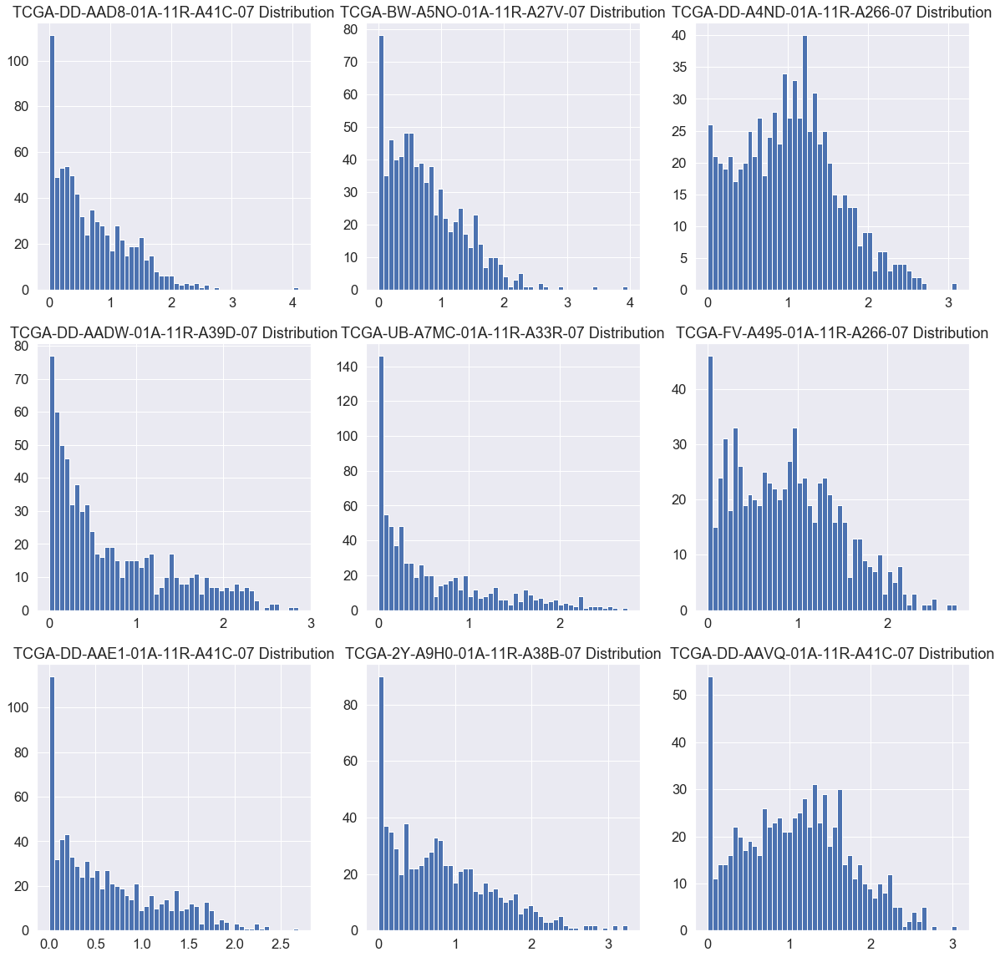

In [26]:
dataf, cm = plot_data(dname="full", transform="zscore-log2", histogram=True, boxplot=True, heatmap=False, dend=False, 
                      clustermap=False)

In [16]:
transform = "log2-zscore"

# dataf, cm = plot_data(dname="full", transform=transform, method="ward", metric="euclidean", histogram=True, boxplot=True, 
#                heatmap=False, dend=False, cmap="coolwarm")
dataf, cm = plot_data(dname="full", transform=transform, method="ward", metric="euclidean", histogram=False, boxplot=False, 
               heatmap=False, dend=False, cmap="coolwarm")
dataf.to_csv('E:\\deeplearning\\Hepatocarcinomes\\TCGA\\processed\\firebrowse_{0}_filtered_nohousekeeping_HCC.csv'.
             format(transform), index=True, sep='\t')

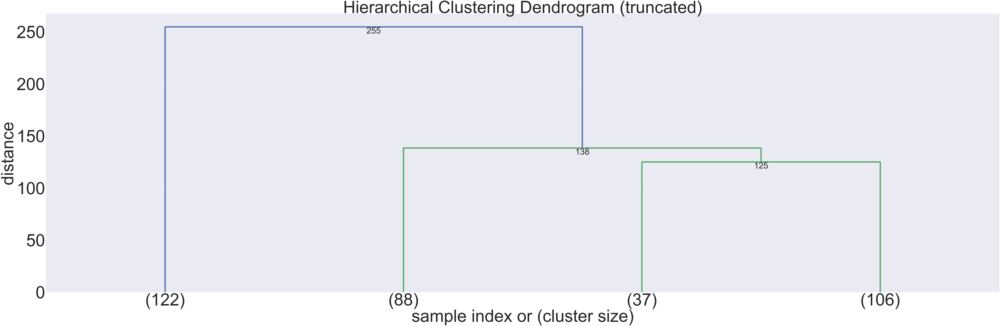

In [17]:
plt.figure(figsize=(200, 60))
plt.rcParams['lines.linewidth'] = 15
fancy_dendrogram(cm.dendrogram_col.linkage, orientation='top', show_leaf_counts=True, truncate_mode='lastp', p=4, 
                 show_contracted=False, leaf_font_size=120, annotate_above=5)
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_full_sample_{0}_ward_euclidean_truncated.png".
             format(transform), dpi=30)
plt.show()

In [24]:
# Plot the sample clustering
plt.figure(figsize=(500, 150))
lwidth_default = 1.75
plt.rcParams['lines.linewidth'] = lwidth_default * 5
fancy_dendrogram(cm.dendrogram_col.linkage, labels=np.asarray(data_classifier.columns), orientation='top', show_leaf_counts=True, 
                 show_contracted=False, leaf_font_size=50, annotate_above=5, max_d=80) # max_d=60
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_full_sample_{0}_ward_euclidean_thres.png".
             format(transform), dpi=60)
plt.show()

In [26]:
clusters_col, samples_clustered = retrieve_cluster(cm=cm, gene_or_sample="sample", dname="full", threshold=80) # threshold=60
samples_clustered.to_csv("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustered_full_sample_{0}_ward_euclidean_thres.csv"
                         .format(transform), index=False)

[1 2 1 9 2 3 3 1 9 1 8 7 1 9 2 1 5 1 9 4 9 9 9 9 4 2 2 3 3 9 2 9 7 9 6 2 7
 1 1 9 6 6 7 1 9 3 2 9 5 1 7 8 3 2 7 7 8 3 3 7 9 9 7 4 6 7 6 7 4 7 3 4 4 5
 7 6 5 9 7 3 7 2 3 9 8 9 8 9 9 9 9 1 9 3 2 4 7 3 5 2 7 7 4 1 4 8 6 6 8 9 8
 9 9 3 8 4 1 3 9 4 9 7 1 2 9 2 5 9 4 7 1 3 2 9 6 9 4 4 1 8 4 2 4 1 1 8 9 9
 8 7 1 6 4 1 2 8 7 6 6 2 2 6 5 6 9 1 4 3 2 2 7 6 9 1 7 7 7 8 4 1 5 1 9 8 1
 1 9 8 9 8 8 9 5 9 7 5 1 9 1 6 2 4 1 8 6 4 9 1 9 1 8 1 1 5 6 3 2 9 4 5 2 4
 4 4 9 2 3 2 5 7 5 6 2 2 5 7 4 4 1 5 9 2 1 6 8 9 2 9 2 9 2 1 6 8 1 8 7 6 2
 1 2 9 9 9 9 8 1 6 3 2 4 2 4 8 7 9 9 7 1 8 4 4 1 4 6 7 7 3 7 2 3 9 2 1 9 9
 1 1 9 4 9 8 2 9 1 9 9 9 9 2 2 6 7 4 7 1 9 9 5 6 1 9 6 4 2 1 1 2 2 6 5 8 9
 2 5 5 1 4 9 2 3 9 2 2 9 9 4 9 6 9 4 6 9]
(353, 2)


,Name,Cluster
0,TCGA-2V-A95S-01A-11R-A37K-07,1
1,TCGA-2Y-A9GT-01A-11R-A38B-07,1
2,TCGA-2Y-A9GY-01A-11R-A38B-07,1
3,TCGA-2Y-A9H0-01A-11R-A38B-07,1
4,TCGA-2Y-A9H3-01A-11R-A38B-07,1


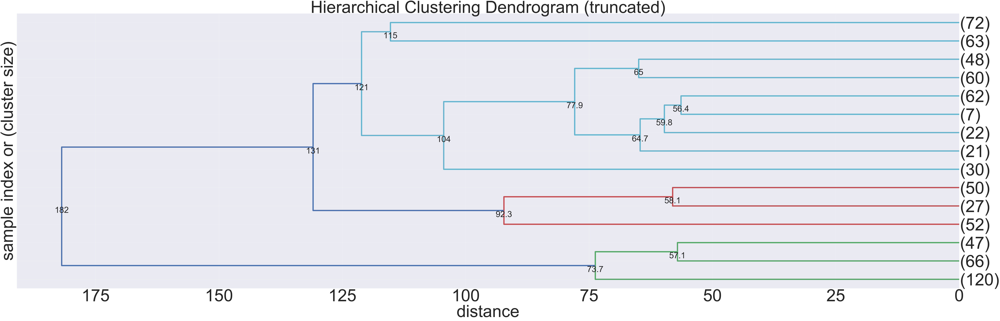

In [62]:
plt.figure(figsize=(200, 60))
plt.rcParams['lines.linewidth'] = 15
fancy_dendrogram(cm.dendrogram_row.linkage, orientation='left', show_leaf_counts=True, truncate_mode='lastp', p=15, 
                 show_contracted=False, leaf_font_size=120, annotate_above=5) # p=9
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_full_sample_{0}_ward_euclidean_truncated.png".
             format(transform), dpi=30)
plt.show()

In [84]:
# Plot the gene clustering
plt.figure(figsize=(500, 150))
plt.rcParams['lines.linewidth'] = 1.75 # 10
fancy_dendrogram(cm.dendrogram_row.linkage, labels=np.asarray(data_full.index), orientation='left', show_leaf_counts=True, 
                 show_contracted=True, leaf_font_size=9, annotate_above=0, max_d=52) # max_d=48
plt.savefig("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\dendrogram_full_gene_{0}_ward_euclidean_thres.png".
             format(transform), dpi=50)
plt.show()

In [64]:
clusters_row, genes_clustered = retrieve_cluster(cm=cm, gene_or_sample="gene", dname="full", threshold=52) # threshold=48
genes_clustered.to_csv("E:\\deeplearning\\Hepatocarcinomes\\TCGA\\heatmap\\clustered_full_genes_{0}_ward_euclidean_thres.csv".
             format(transform), index=False)

[14  6  3 18  4  6  5 11 13 14  3  3  9 14 14  2  1 18 16  3  3 16  8 15
 11  2 18  8  8 16 13  5  3  3  3  2 18 18 18 18  3 14 15  3 14  4  4 11
  2  5 16  6  3 10 14  1  1  1  1  2 13 18  1 13  3  3 18 18  8 10  1  3
 16  2  3  3 10 13  5  1 16  8 18 11  6 16  2 16 16  1 16  1 15 14 16  9
  5 13  5  2 14 14  5 18  8 16  2  5  3  6  4 13  4 11  2 18  8 16 18  8
 14 18  2 18  7 13  9  3  9  1 16 18  3 12  8 15  2 10  8 14 14 15 15 13
  1 15  2  9 11 13 13 13  8 15 13  1  2 16  4  3 15 15  7  1  3 18  7  3
 13  9 13  9 10 15  4  7  1 13 13  1 18  2 13  9  3 14 14  2 18 12  8 16
 10 11 16  2  8 16  3  3 15  1 16  2 10 16 17 11 13 18  4 18  3  8 10 14
 15  6  2 18  3  1 16  4  3 13 16  3  6 16  2 17 17  8 18  8 16  7 15 18
 18  7  1  4  4 16 16  3  6  3  2  4  1 14  8 18 14 13 18 18  7  1 13  5
 18  1 14 15 13  3  5 13 16 10 13  7 15  3 18  7  2  9 14  6 15  2  4 16
  2  3 16 14  5 14  7  5  8 15  2 15 14 14  2 11  8 16  9 18  8  4 13  4
  1 16  3  6  4  2  6  9 13  8  7 14 16 12 15  7 10

,Name,Cluster
0,KLRB1,1
1,LCK,1
2,LY9,1
3,KLRD1,1
4,CD70,1


In [65]:
dataf, cm = plot_data(dname="full", transform=transform, method="ward", clusters_row=clusters_row, clusters_col=clusters_col, 
               cmap="coolwarm", histogram=False, boxplot=False, heatmap=False, dend=False) # The Ward’s linkage supports only the Euclidean distance

In [66]:
clusters_row

Gene Name
CDKN2A      14
GBP2         6
TLR8         3
SNCA        18
BIRC3        4
            ..
C6ORF150     4
MRE11A      16
EMR1         3
DEPDC6       8
IL8         14
Length: 747, dtype: int32